In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly_express as px
#openpyxl

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [2]:
# Making numbers easy to read
pd.options.display.float_format = ':20.2f'.format

In [3]:
df = pd.read_excel('online_retail.xlsx',sheet_name=0)

- InvoiceNo: Invoice number. Nominal. A 6-digit integral number uniquely assigned to each transaction. If this code starts with the letter 'c', it indicates a cancellation. 
- StockCode: Product (item) code. Nominal. A 5-digit integral number uniquely assigned to each distinct product. 
- Description: Product (item) name. Nominal. 
- Quantity: The quantities of each product (item) per transaction. Numeric.	
- InvoiceDate: Invice date and time. Numeric. The day and time when a transaction was generated. 
- UnitPrice: Unit price. Numeric. Product price per unit in sterling (Â£). 
- CustomerID: Customer number. Nominal. A 5-digit integral number uniquely assigned to each customer. 
- Country: Country name. Nominal. The name of the country where a customer resides.

In [4]:
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom


#### EDA

In [5]:
df.shape

(525461, 8)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525461 entries, 0 to 525460
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   Invoice      525461 non-null  object        
 1   StockCode    525461 non-null  object        
 2   Description  522533 non-null  object        
 3   Quantity     525461 non-null  int64         
 4   InvoiceDate  525461 non-null  datetime64[ns]
 5   Price        525461 non-null  float64       
 6   Customer ID  417534 non-null  float64       
 7   Country      525461 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 32.1+ MB


In [7]:
df.describe()

,Quantity,InvoiceDate,Price,Customer ID
count,:20.2f,525461,:20.2f,:20.2f
mean,:20.2f,2010-06-28 11:37:36.845017856,:20.2f,:20.2f
min,:20.2f,2009-12-01 07:45:00,:20.2f,:20.2f
25%,:20.2f,2010-03-21 12:20:00,:20.2f,:20.2f
50%,:20.2f,2010-07-06 09:51:00,:20.2f,:20.2f
75%,:20.2f,2010-10-15 12:45:00,:20.2f,:20.2f
max,:20.2f,2010-12-09 20:01:00,:20.2f,:20.2f
std,:20.2f,NaN,:20.2f,:20.2f


- There are -ve values for quantity and price (might be cancelled transactions)

In [8]:
# Checking Canceld Transactions (invoice no. starting with 'c')

df[df.Price<0] # Only 3 entries
df[df.Quantity<0].sample(10) # Most of them are related to cancellation

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
274677,516121,22604,NaN,-2560,2010-07-16 14:59:00,:20.2f,NaN,United Kingdom
264890,514997,47599A,NaN,-105,2010-07-07 14:54:00,:20.2f,NaN,United Kingdom
253182,C513780,21679,SKULLS STICKERS,-288,2010-06-28 14:15:00,:20.2f,:20.2f,United Kingdom
304300,C519043,79323W,WHITE CHERRY LIGHTS,-7,2010-08-13 11:29:00,:20.2f,:20.2f,United Kingdom
158206,C504461,22456,NATURAL SLATE CHALKBOARD LARGE,-6,2010-04-13 16:22:00,:20.2f,:20.2f,United Kingdom
427261,C530170,22061,LARGE CAKE STAND HANGING STRAWBERY,-1,2010-11-02 09:55:00,:20.2f,:20.2f,United Kingdom
379183,C525930,35004B,SET OF 3 BLACK FLYING DUCKS,-2,2010-10-07 16:54:00,:20.2f,:20.2f,United Kingdom
294276,C518057,84755,COLOUR GLASS T-LIGHT HOLDER HANGING,-144,2010-08-04 11:51:00,:20.2f,:20.2f,United Kingdom
136411,C502459,BANK CHARGES,Bank Charges,-1,2010-03-24 14:25:00,:20.2f,NaN,United Kingdom
80388,496762,79082C,NaN,-2,2010-02-03 15:04:00,:20.2f,NaN,United Kingdom


In [9]:
df.nunique()

Invoice        28816
StockCode       4632
Description     4681
Quantity         825
InvoiceDate    25296
Price           1606
Customer ID     4383
Country           40
dtype: int64

In [ ]:
# exploring Invoice Column
df['Invoice'] = df['Invoice'].astype('str')
df[~df.Invoice.str.match('^\\d{6}')]
# Invoice starting with C indicates that they are cancelled transactions

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
178,C489449,22087,PAPER BUNTING WHITE LACE,-12,2009-12-01 10:33:00,:20.2f,:20.2f,Australia
179,C489449,85206A,CREAM FELT EASTER EGG BASKET,-6,2009-12-01 10:33:00,:20.2f,:20.2f,Australia
180,C489449,21895,POTTING SHED SOW 'N' GROW SET,-4,2009-12-01 10:33:00,:20.2f,:20.2f,Australia
181,C489449,21896,POTTING SHED TWINE,-6,2009-12-01 10:33:00,:20.2f,:20.2f,Australia
182,C489449,22083,PAPER CHAIN KIT RETRO SPOT,-12,2009-12-01 10:33:00,:20.2f,:20.2f,Australia
...,...,...,...,...,...,...,...,...
524695,C538123,22956,36 FOIL HEART CAKE CASES,-2,2010-12-09 15:41:00,:20.2f,:20.2f,Germany
524696,C538124,M,Manual,-4,2010-12-09 15:43:00,:20.2f,:20.2f,United Kingdom
524697,C538124,22699,ROSES REGENCY TEACUP AND SAUCER,-1,2010-12-09 15:43:00,:20.2f,:20.2f,United Kingdom
524698,C538124,22423,REGENCY CAKESTAND 3 TIER,-1,2010-12-09 15:43:00,:20.2f,:20.2f,United Kingdom


In [18]:
df.Invoice.str.replace('[0-9]','',regex=True).value_counts()

Invoice
     515252
C     10206
A         3
Name: count, dtype: int64

In [19]:
df[df.Invoice.str.startswith('A')]

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
179403,A506401,B,Adjust bad debt,1,2010-04-29 13:36:00,:20.2f,NaN,United Kingdom
276274,A516228,B,Adjust bad debt,1,2010-07-19 11:24:00,:20.2f,NaN,United Kingdom
403472,A528059,B,Adjust bad debt,1,2010-10-20 12:04:00,:20.2f,NaN,United Kingdom


In [20]:
# Exploring StockCode
df['StockCode'] = df['StockCode'].astype('str')
df.StockCode.head()
# stockcode is supposed to be a 5 digit int

0     85048
1    79323P
2    79323W
3     22041
4     21232
Name: StockCode, dtype: object

In [65]:
sus_stock_codes = df[~df.StockCode.str.match('^\\d{5}')].StockCode
sus_stock_codes.unique()

array(['POST', 'D', 'DCGS0058', 'DCGS0068', 'DOT', 'M', 'DCGS0004',
       'DCGS0076', 'C2', 'BANK CHARGES', 'DCGS0003', 'TEST001',
       'gift_0001_80', 'DCGS0072', 'gift_0001_20', 'DCGS0044', 'TEST002',
       'gift_0001_10', 'gift_0001_50', 'DCGS0066N', 'gift_0001_30',
       'PADS', 'ADJUST', 'gift_0001_40', 'gift_0001_60', 'gift_0001_70',
       'gift_0001_90', 'DCGSSGIRL', 'DCGS0006', 'DCGS0016', 'DCGS0027',
       'DCGS0036', 'DCGS0039', 'DCGS0060', 'DCGS0056', 'DCGS0059', 'GIFT',
       'DCGSLBOY', 'm', 'DCGS0053', 'DCGS0062', 'DCGS0037', 'DCGSSBOY',
       'DCGSLGIRL', 'S', 'DCGS0069', 'DCGS0070', 'DCGS0075', 'B',
       'DCGS0041', 'ADJUST2', 'C3', 'SP1002', 'AMAZONFEE'], dtype=object)

In [ ]:
# exploring each invalid stock codes
df[df['StockCode']=='AMAZONFEE']

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
377066,525772,SP1002,KID'S CHALKBOARD/EASEL,1,2010-10-07 11:12:00,:20.2f,:20.2f,United Kingdom
377387,525837,SP1002,KID'S CHALKBOARD/EASEL,4,2010-10-07 12:23:00,:20.2f,:20.2f,United Kingdom
426694,530135,SP1002,NaN,-27,2010-11-01 15:33:00,:20.2f,NaN,United Kingdom


In [ ]:
stock_codes_to_keep = [
    'PADS',
    'SP1002'    
]

In [95]:
px.histogram(df,x='Quantity',nbins=25)

- Most of the transactions quantities is less than 2000 

In [13]:
px.histogram(df,x='InvoiceDate',nbins=48)

- There is a spike in transactions after september

In [27]:
px.histogram(df,'Price',nbins=40)

- Neg values are present 
- most of the price are below 1000

In [31]:
px.bar(df.Country.value_counts()[:10])

In [ ]:
df.Country.value_counts(ascending=True).head(20).sum()
# only ~2000 transactions occure from the last 20 countries

np.int64(2265)

- United Kingdom contributes most of the transactions

#### Data Cleaning

In [32]:
df.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [33]:
df.isna().sum()

Invoice             0
StockCode           0
Description      2928
Quantity            0
InvoiceDate         0
Price               0
Customer ID    107927
Country             0
dtype: int64

In [3]:
cleaned_df = df.copy()

NameError: name 'df' is not defined

In [ ]:
# cleaning Invoice
cleaned_df = df[df['Invoice'].str.match('^\\d{6}')]

In [45]:
# Removing entries with invalid customers
cleaned_df = cleaned_df.dropna(subset=['Customer ID'])
cleaned_df.isna().sum()

Invoice        0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
Price          0
Customer ID    0
Country        0
dtype: int64

In [ ]:
# Fixing Stock Codes
cleaned_df = cleaned_df[(cleaned_df['StockCode'].str.match('^\\d{5}')) | (cleaned_df['StockCode'].isin(stock_codes_to_keep))]

In [47]:
cleaned_df.Quantity.describe()

count   :20.2f
mean    :20.2f
std     :20.2f
min     :20.2f
25%     :20.2f
50%     :20.2f
75%     :20.2f
max     :20.2f
Name: Quantity, dtype: float64

In [56]:
cleaned_df.Price.describe()

count   :20.2f
mean    :20.2f
std     :20.2f
min     :20.2f
25%     :20.2f
50%     :20.2f
75%     :20.2f
max     :20.2f
Name: Price, dtype: float64

In [59]:
cleaned_df = cleaned_df[cleaned_df.Price > 0]

In [60]:
cleaned_df.Price.describe()

count   :20.2f
mean    :20.2f
std     :20.2f
min     :20.2f
25%     :20.2f
50%     :20.2f
75%     :20.2f
max     :20.2f
Name: Price, dtype: float64

In [69]:
cleaned_df.describe()

,Quantity,InvoiceDate,Price,Customer ID
count,:20.2f,407664,:20.2f,:20.2f
mean,:20.2f,2010-07-01 10:15:11.871688192,:20.2f,:20.2f
min,:20.2f,2009-12-01 07:45:00,:20.2f,:20.2f
25%,:20.2f,2010-03-26 14:01:00,:20.2f,:20.2f
50%,:20.2f,2010-07-09 15:47:00,:20.2f,:20.2f
75%,:20.2f,2010-10-14 17:09:00,:20.2f,:20.2f
max,:20.2f,2010-12-09 20:01:00,:20.2f,:20.2f
std,:20.2f,NaN,:20.2f,:20.2f


In [72]:
cleaned_df.isna().sum()

Invoice        0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
Price          0
Customer ID    0
Country        0
dtype: int64

In [70]:
# Percentage of data retained
cleaned_df.shape[0]/df.shape[0]*100

77.5821611879854

- Dropped  ~23% of the data

### Feature Engineering

In [73]:
cleaned_df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,:20.2f,:20.2f,United Kingdom


In [77]:
cleaned_df['GrandTotal'] = cleaned_df.Price * cleaned_df.Quantity
cleaned_df['GrandTotal'].describe()

count   :20.2f
mean    :20.2f
std     :20.2f
min     :20.2f
25%     :20.2f
50%     :20.2f
75%     :20.2f
max     :20.2f
Name: GrandTotal, dtype: float64

In [164]:
grouped_df = cleaned_df.groupby('Customer ID',as_index=False) \
    .agg(
        no_of_purchase = ('Invoice','nunique'),
        monetary_value = ('GrandTotal','sum'),
        last_invoice_date = ('InvoiceDate','max'),
    )
grouped_df.describe()

,Customer ID,no_of_purchase,monetary_value,last_invoice_date
count,:20.2f,:20.2f,:20.2f,4312
mean,:20.2f,:20.2f,:20.2f,2010-09-10 09:08:37.138219008
min,:20.2f,:20.2f,:20.2f,2009-12-01 09:55:00
25%,:20.2f,:20.2f,:20.2f,2010-07-27 09:53:00
50%,:20.2f,:20.2f,:20.2f,2010-10-18 16:34:30
75%,:20.2f,:20.2f,:20.2f,2010-11-22 11:01:30
max,:20.2f,:20.2f,:20.2f,2010-12-09 20:01:00
std,:20.2f,:20.2f,:20.2f,NaN


In [165]:
# lets take the latest purchase date in the dataset as our reference point ( i.r.l. it the current date )
latest_purchase_date = grouped_df['last_invoice_date'].max()
grouped_df['recency'] = (latest_purchase_date - grouped_df['last_invoice_date']).dt.days
grouped_df.recency.describe()

count   :20.2f
mean    :20.2f
std     :20.2f
min     :20.2f
25%     :20.2f
50%     :20.2f
75%     :20.2f
max     :20.2f
Name: recency, dtype: float64

In [166]:
from plotly.subplots import make_subplots

fig1 = px.box(grouped_df.no_of_purchase)
fig2 = px.box(grouped_df.monetary_value)
fig3 = px.box(grouped_df.recency)

fig = make_subplots(rows=1,cols=3,
                    subplot_titles=['No Of Purchase','Monetary Value', 'Recency'])

fig.add_trace(fig1.data[0], 1,1)
fig.add_trace(fig2.data[0],1,2)
fig.add_trace(fig3.data[0],1,3)

fig.update_layout(height=500,width = 1500)


- For our clustering, Data points which vary highly from the rest should be removed
- Here, recency look fine, but both other have outliers

In [167]:
def get_outliers(df,col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)

    IQR = (Q3 - Q1) 

    upper_limit = Q3 + IQR * 1.5
    lower_limit = Q1 - IQR * 1.5

    outliers_df = df[(df[col]<lower_limit) | (df[col]>upper_limit) ]
    return outliers_df

In [168]:
purchase_outliers = get_outliers(grouped_df,'no_of_purchase')
purchase_outliers.head()

,Customer ID,no_of_purchase,monetary_value,last_invoice_date,recency
56,:20.2f,14,:20.2f,2010-11-10 13:19:00,29
63,:20.2f,13,:20.2f,2010-12-01 10:03:00,8
67,:20.2f,21,:20.2f,2010-11-09 14:46:00,30
87,:20.2f,49,:20.2f,2010-11-30 14:35:00,9
88,:20.2f,13,:20.2f,2010-12-05 14:19:00,4


In [169]:
monatery_value_outliers = get_outliers(grouped_df,'monetary_value')
monatery_value_outliers.head()

,Customer ID,no_of_purchase,monetary_value,last_invoice_date,recency
9,:20.2f,2,:20.2f,2010-11-16 14:29:00,23
26,:20.2f,7,:20.2f,2010-08-31 14:54:00,100
44,:20.2f,4,:20.2f,2010-10-15 10:24:00,55
50,:20.2f,7,:20.2f,2010-11-29 15:07:00,10
56,:20.2f,14,:20.2f,2010-11-10 13:19:00,29


In [170]:
outliers_removed = grouped_df[(~(grouped_df.isin(purchase_outliers)) & (~grouped_df.isin(monatery_value_outliers)) )].dropna()

In [171]:
fig1 = px.box(outliers_removed.no_of_purchase)
fig2 = px.box(outliers_removed.monetary_value)
fig3 = px.box(outliers_removed.recency)

fig = make_subplots(rows=1,cols=3,
                    subplot_titles= ['No Of Purchase','Monetary Value', 'Recency']
                    )
fig.add_trace(fig1.data[0],1,1)
fig.add_trace(fig2.data[0],1,2)
fig.add_trace(fig3.data[0],1,3)

fig.update_layout(height=500,width = 1500)

In [179]:
outliers_removed.describe()

,Customer ID,no_of_purchase,monetary_value,last_invoice_date,recency
count,:20.2f,:20.2f,:20.2f,3828,:20.2f
mean,:20.2f,:20.2f,:20.2f,2010-09-02 15:28:27.931034368,:20.2f
min,:20.2f,:20.2f,:20.2f,2009-12-01 09:55:00,:20.2f
25%,:20.2f,:20.2f,:20.2f,2010-07-07 12:00:45,:20.2f
50%,:20.2f,:20.2f,:20.2f,2010-10-12 12:44:30,:20.2f
75%,:20.2f,:20.2f,:20.2f,2010-11-17 13:09:30,:20.2f
max,:20.2f,:20.2f,:20.2f,2010-12-09 20:01:00,:20.2f
std,:20.2f,:20.2f,:20.2f,NaN,:20.2f


In [160]:
fig1 = px.box(outliers_removed.no_of_purchase)
fig2 = px.box(outliers_removed.monetary_value)
fig3 = px.box(outliers_removed.recency)

fig = make_subplots(rows=1,cols=3,
                    subplot_titles= ['No Of Purchase','Monetary Value', 'Recency']
                    )
fig.add_trace(fig1.data[0],1,1)
fig.add_trace(fig2.data[0],1,2)
fig.add_trace(fig3.data[0],1,3)

fig.update_layout(height=500,width = 1500)

In [ ]:
# Percentage of customers retained
outliers_removed.shape[0]/grouped_df.shape[0]*100

88.77551020408163

In [ ]:
# fig = px.scatter_3d(outliers_removed,x='no_of_purchase',y='monetary_value',z='recency')
# fig.update_layout(height=1500,width = 1500)

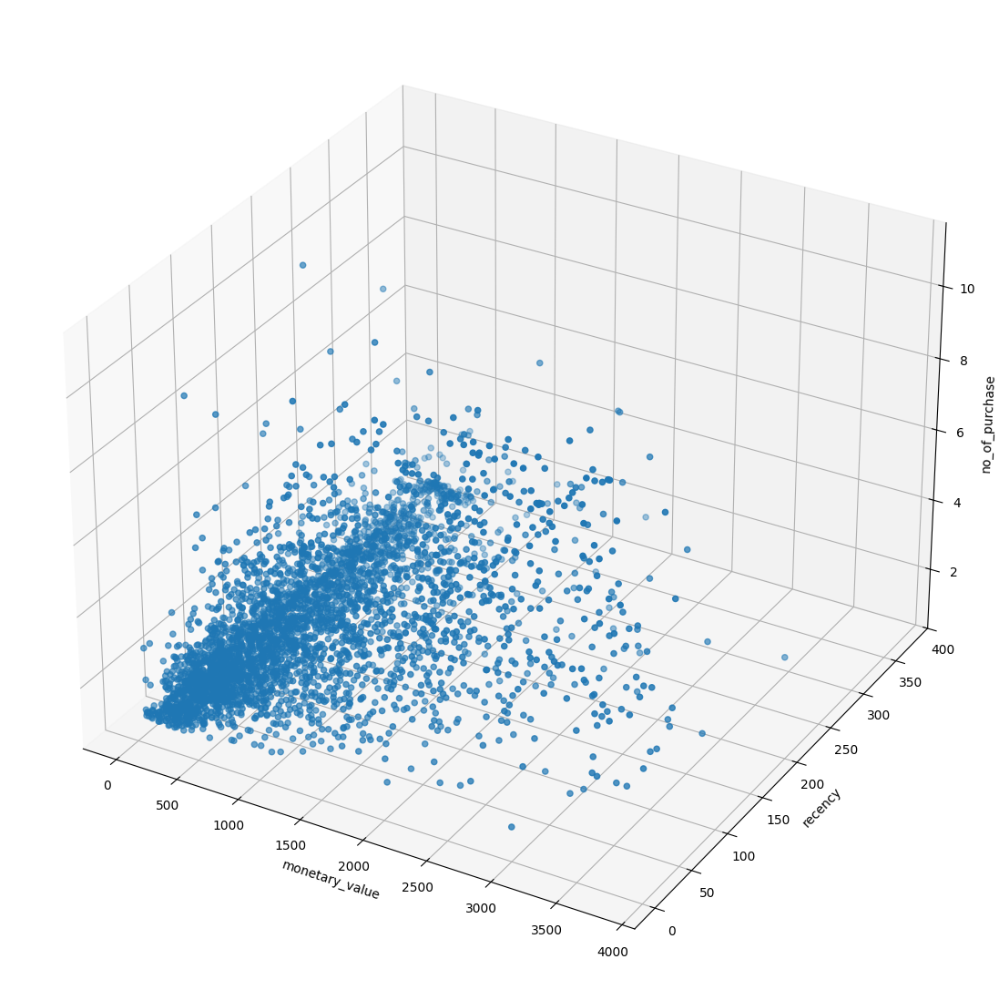

In [186]:
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(projection='3d')
scatter = ax.scatter(outliers_removed.monetary_value,outliers_removed.recency,outliers_removed.no_of_purchase)
ax.set_xlabel('monetary_value')
ax.set_ylabel('recency')
ax.set_zlabel('no_of_purchase')
plt.show()

### Clustering

In [189]:
outliers_removed.head()

,Customer ID,no_of_purchase,monetary_value,last_invoice_date,recency
0,:20.2f,:20.2f,:20.2f,2010-06-28 13:53:00,:20.2f
1,:20.2f,:20.2f,:20.2f,2010-12-07 14:57:00,:20.2f
2,:20.2f,:20.2f,:20.2f,2010-09-27 14:59:00,:20.2f
3,:20.2f,:20.2f,:20.2f,2010-10-28 08:23:00,:20.2f
4,:20.2f,:20.2f,:20.2f,2010-11-29 15:23:00,:20.2f


In [190]:
std_scalar = StandardScaler()
scaled_data = std_scalar.fit_transform(outliers_removed[['no_of_purchase','monetary_value','recency']])
scaled_data

array([[ 3.62975807, -0.62689958,  0.66943051],
       [-0.38566835,  0.52559219, -0.9714245 ],
       [-0.83182684, -0.80963268, -0.25228434],
       ...,
       [-0.83182684, -0.56125147,  1.99629474],
       [-0.38566835,  0.49298639,  0.13260757],
       [ 0.50664863,  1.76530355, -0.81949348]], shape=(3828, 3))

In [192]:
n_clusters = range(2,12+1)

inertia_history = []

for cluster in n_clusters:
    model = KMeans( n_clusters=cluster, max_iter=1000,random_state=42)
    predicted_clusters  = model.fit(scaled_data)
    inertia_history.append(model.inertia_)

inertia_history
    

[6211.368763874545,
 3629.0719606121124,
 2787.0480062036645,
 2405.195806413288,
 2141.2310806400965,
 1960.5085333628358,
 1639.1140486992822,
 1488.2663667328022,
 1413.0040214186129,
 1329.0254663490539,
 1280.7955087698863]

<Axes: >

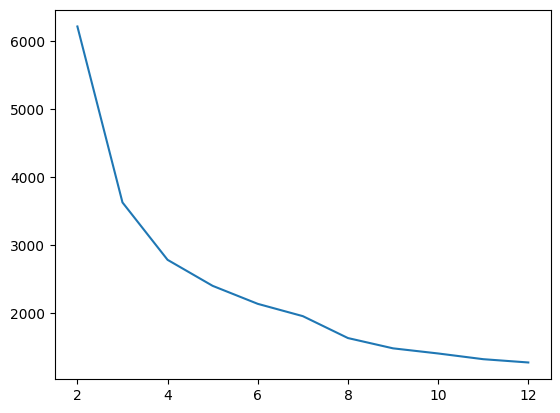

In [199]:
plt.Figure(figsize=(12,8))
sns.lineplot(x=n_clusters,y=inertia_history)

- Using elbow method, both 4 and 5 clusters look promissing

In [200]:
from sklearn.metrics import silhouette_score

n_clusters = range(2,12+1)

inertia_history = []
sil_score_history = []

for cluster in n_clusters:
    model = KMeans( n_clusters=cluster, max_iter=1000,random_state=42)
    predicted_clusters  = model.fit_predict(scaled_data)
    sil_score = silhouette_score(scaled_data,predicted_clusters)
    
    inertia_history.append(model.inertia_)
    sil_score_history.append(sil_score)

sil_score_history    

[0.44336166146766537,
 0.4585230466705131,
 0.4145529694414841,
 0.4049821024748708,
 0.375867001082855,
 0.3645985913807635,
 0.3653332733159356,
 0.3619670530897399,
 0.35091113188339057,
 0.33795805763467446,
 0.32120032645098856]

In [1]:
plt.figure(figsize=(16,8))
sns.set_style('whitegrid')
plt.subplot(1,2,1)
sns.lineplot(x=n_clusters,y=inertia_history)
plt.title('Intertia VS No of clusters')
plt.xlabel('No of clusters')
plt.ylabel('Intertia')

plt.subplot(1,2,2)
sns.lineplot(x=n_clusters,y=sil_score_history)
plt.title('Silhouette score VS No of clusters')
plt.xlabel('No of clusters')
plt.ylabel('Silhouette score')
plt.savefig("assets/ModelEvaluation.png", bbox_inches="tight")

NameError: name 'plt' is not defined

- this shows that after 4 clusters, there is a dip in performance/quality of the clusters
- therefore our ideal value for k is 4

In [219]:
model = KMeans(n_clusters=4,max_iter=1000,random_state=42)
predicted_clusters = model.fit_predict(scaled_data)

In [223]:
scaled_data_df = pd.DataFrame(scaled_data)
scaled_data_df

,0,1,2
0,:20.2f,:20.2f,:20.2f
1,:20.2f,:20.2f,:20.2f
2,:20.2f,:20.2f,:20.2f
3,:20.2f,:20.2f,:20.2f
4,:20.2f,:20.2f,:20.2f
...,...,...,...
3823,:20.2f,:20.2f,:20.2f
3824,:20.2f,:20.2f,:20.2f
3825,:20.2f,:20.2f,:20.2f
3826,:20.2f,:20.2f,:20.2f


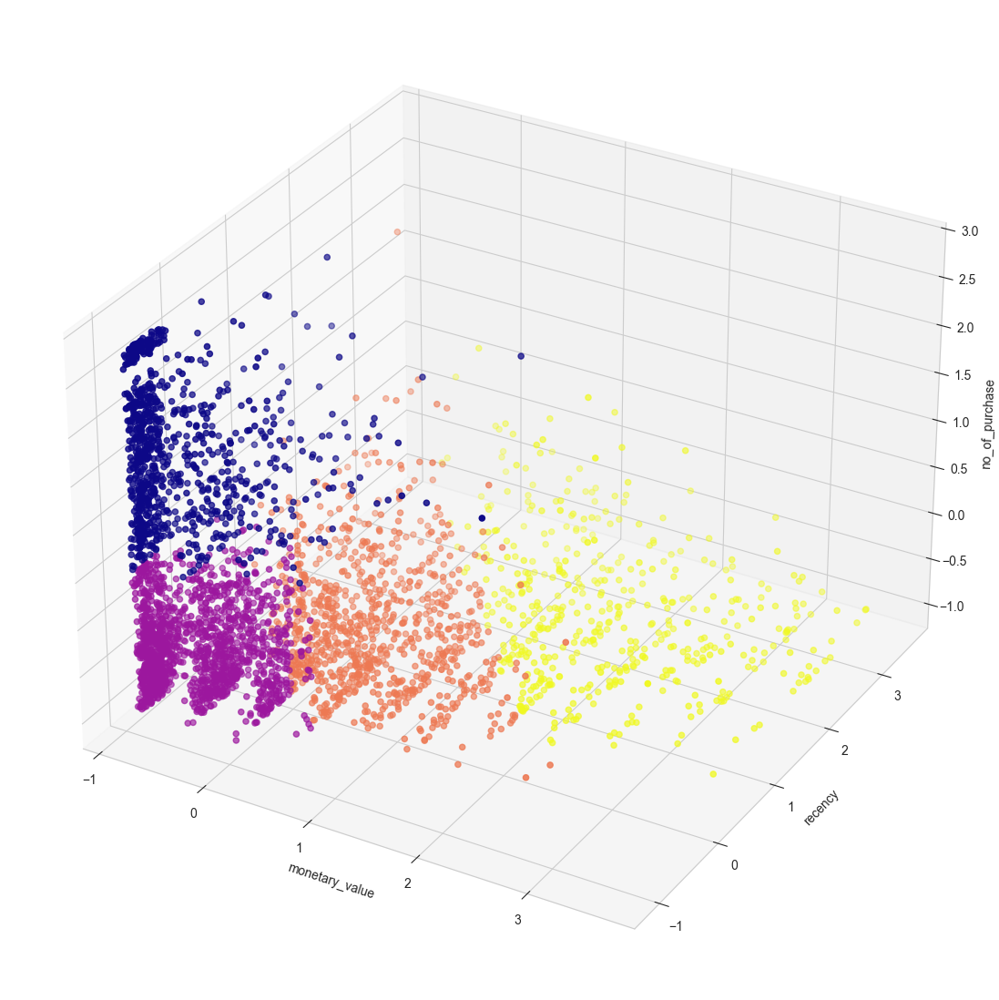

In [231]:
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(projection='3d')
scatter = ax.scatter(scaled_data_df[0],scaled_data_df[1],scaled_data_df[2],c=predicted_clusters,cmap='plasma')
ax.set_zlabel('no_of_purchase')
ax.set_xlabel('monetary_value')
ax.set_ylabel('recency')
plt.show()

In [259]:
outliers_removed['cluster'] = predicted_clusters
cluster_names = {
    0:'Inactive Low Buyers',
    1:'Recent Low Spenders',
    2:'Mid-Value Regulars',
    3:'High-Value Actives'    
}
outliers_removed['cluster_name'] = outliers_removed.cluster.map(cluster_names)

Text(0.5, 1.0, 'distribution of total purchases value among clusturs')

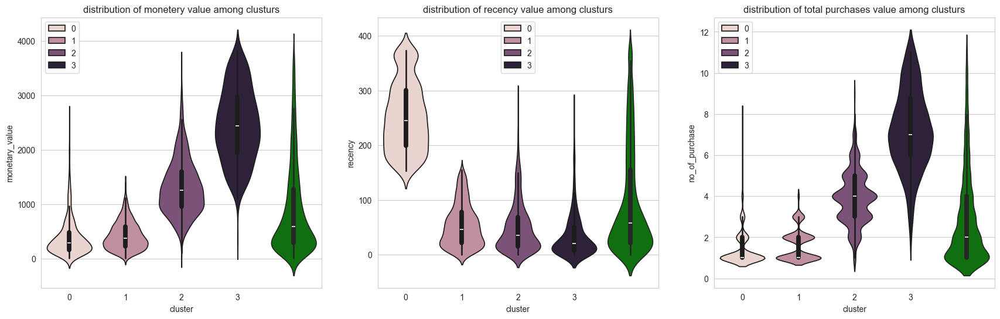

In [242]:
plt.figure(figsize=(21,6))
plt.subplot(1,3,1)
sns.violinplot(x=outliers_removed.cluster,y=outliers_removed.monetary_value,hue=outliers_removed.cluster)
sns.violinplot(y=outliers_removed.monetary_value,color='green')
plt.title('distribution of monetery value among clusturs')
plt.subplot(1,3,2)
sns.violinplot(x=outliers_removed.cluster,y=outliers_removed.recency,hue=outliers_removed.cluster)
sns.violinplot(y=outliers_removed.recency,color='green')
plt.title('distribution of recency value among clusturs')

plt.subplot(1,3,3)
sns.violinplot(x=outliers_removed.cluster,y=outliers_removed.no_of_purchase,hue=outliers_removed.cluster)
sns.violinplot(y=outliers_removed.no_of_purchase,color='green')
plt.title('distribution of total purchases value among clusturs')

Text(0.5, 1.0, 'distribution of customer belonging to various clusters')

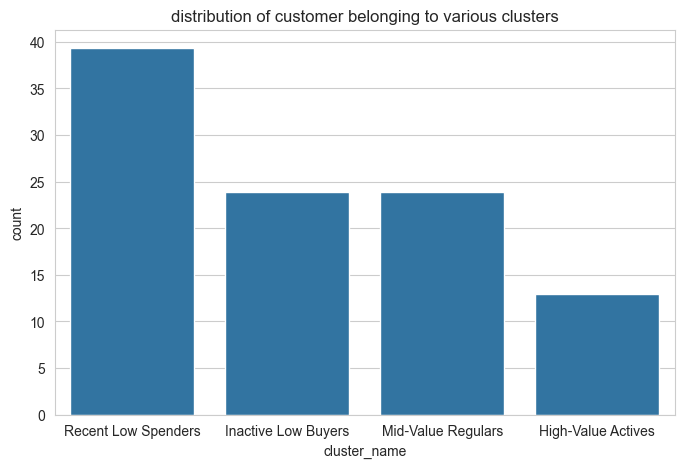

In [270]:
cluster_distribution = outliers_removed.cluster_name.value_counts()/outliers_removed.shape[0]*100
plt.figure(figsize=(8,5))
ax = sns.barplot(cluster_distribution)
plt.title('distribution of customer belonging to various clusters')

# Clustering Summary
**Cluster 0 (Inactive Low Buyers)** \
    `low monetary value | low recency | low no. of purchase`
- This cluster represents irregular low sending customers. 
- The focus should be to bring them to active purchasing behavior.
- Targeted marketing campaigns, discounts, notifications/messages, etc can help bringing them to active purchasing.
    

**Cluster 1 (Recent Low Spenders)** \
    `low monetary value | high recency | low no. of purchase`
- This cluster represents low spending customers who purchases almost regularly.
- The focus should be to make them spend more, while retaining their frequent buying behavior.
- offer personalized discounts, Show ads on related high-value products (recommend products related to their past purchases) , introduce bonus points/discount on reaching a specific spending threshold.

**Cluster 2 (Mid-Value Regulars)** \
    `medium monetary value | medium to high recency | medium no. of purchase`
- This cluster represent moderate active, mid-spending customers who are potential loyal customers. They can potentially provide long term value.
- The focus should be to keep them happy while encouraging them to make more purchases. 
- Reward consicutive purchases, Ask reviews (this information can be valuable), Predictive remainders based on buying patterns, imporove customer serivice. 

**Cluster 3 (High-Value Actives)** \
    - `high monetary value | high recency | high no. of purchase`
- This cluster is the most active, high spending loyal customers who provides the highest value.
- The focus should be to keep them valued and prevent churning to the competitors.
- Providing Personalized appreciation messages, host community meet-ups and bonus gifts, early access, fast delevery, etc can help.

In [275]:
high_frequent_high_monetery_index = monatery_value_outliers.index.intersection( purchase_outliers.index)
high_monetery_outliers = monatery_value_outliers[~monatery_value_outliers.index.isin(high_frequent_high_monetery_index)]
high_frequency_outliers = purchase_outliers[~purchase_outliers.index.isin(high_frequent_high_monetery_index)]
high_frequent_high_monetery = grouped_df.loc[high_frequent_high_monetery_index]

In [ ]:
high_monetery_outliers['cluster'] = -1
high_frequency_outliers['cluster'] = -2
high_frequent_high_monetery['cluster'] = -3
outlier_df = pd.concat([high_monetery_outliers,high_frequency_outliers,high_frequent_high_monetery])

Text(0.5, 0, 'recency')

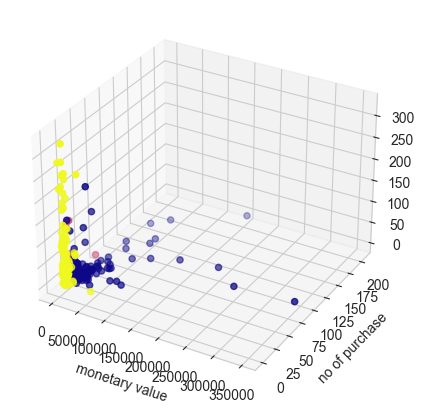

In [282]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(projection='3d')
ax.scatter3D(outlier_df.monetary_value,outlier_df.no_of_purchase,outlier_df.recency,c=outlier_df.cluster,cmap='plasma')
ax.set_xlabel('monetary value')
ax.set_ylabel('no of purchase')
ax.set_zlabel('recency')

Text(0.5, 1.0, 'distribution of total purchases value among clusturs')

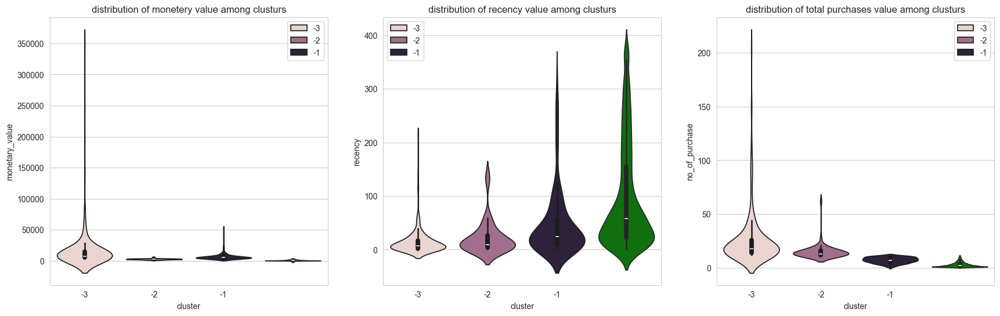

In [289]:
plt.figure(figsize=(21,6))
plt.subplot(1,3,1)
sns.violinplot(x=outlier_df.cluster,y=outlier_df.monetary_value,hue=outlier_df.cluster)
sns.violinplot(y=outliers_removed.monetary_value,color='green')
plt.title('distribution of monetery value among clusturs')
plt.subplot(1,3,2)
sns.violinplot(x=outlier_df.cluster,y=outlier_df.recency,hue=outlier_df.cluster)
sns.violinplot(y=outliers_removed.recency,color='green')
plt.title('distribution of recency value among clusturs')
plt.subplot(1,3,3)
sns.violinplot(x=outlier_df.cluster,y=outlier_df.no_of_purchase,hue=outlier_df.cluster)
sns.violinplot(y=outliers_removed.no_of_purchase,color='green')
plt.title('distribution of total purchases value among clusturs')

#### Outliers Clustering (High Performance People)
(comparing high performing groups) 

 
**Cluster:  -1 (At-Risk High Spenders)** \
`High monetary value | Poor Recency |  Comparitively low Purchases`
- This cluster represent customers that have spend large amount but are not actively purchasing.
- Focus on personalization with complimentary offers. Targetted Marketing, Ads, etc can help. Churn diagnostics can be valuable.

**Cluster:  -2 (Engaged High-Value Customers)** \
`Good Monetery Value | Good Recency | High Purchases`
- This cluster represent customers spending good and are also relatively active.
- Reward consicutive purchases, Predictive remainders based on buying patterns, Targetted Relevant Ads can help.

**Cluster:  -3 (Top-Tier Customers)** \
`Very High Monetery | Very Active Recency | Vary High Purchases`
- This cluster represent customers that spends the Maximum and Most of them are active.
- This is our most valuable group of customers, who brings the most revenue.
- Personalized Thanking Messages, Free Surprise Gifts, VIP exclusive programs/offers

In [294]:
outlier_cluster_names = {
    -1:'At-Risk High Spenders',
    -2:'Engaged High-Value Customers',
    -3:'Top-Tier Customers'
}
outlier_df['cluster_name'] = outlier_df['cluster'].map(outlier_cluster_names)

In [295]:
full_df = pd.concat([outliers_removed,outlier_df])
full_df

,Customer ID,no_of_purchase,monetary_value,last_invoice_date,recency,cluster,cluster_name
0,:20.2f,:20.2f,:20.2f,2010-06-28 13:53:00,:20.2f,3,High-Value Actives
1,:20.2f,:20.2f,:20.2f,2010-12-07 14:57:00,:20.2f,2,Mid-Value Regulars
2,:20.2f,:20.2f,:20.2f,2010-09-27 14:59:00,:20.2f,1,Recent Low Spenders
3,:20.2f,:20.2f,:20.2f,2010-10-28 08:23:00,:20.2f,2,Mid-Value Regulars
4,:20.2f,:20.2f,:20.2f,2010-11-29 15:23:00,:20.2f,1,Recent Low Spenders
...,...,...,...,...,...,...,...
4262,:20.2f,:20.2f,:20.2f,2010-11-17 12:20:00,:20.2f,-3,Top-Tier Customers
4263,:20.2f,:20.2f,:20.2f,2010-12-09 15:46:00,:20.2f,-3,Top-Tier Customers
4264,:20.2f,:20.2f,:20.2f,2010-11-26 15:51:00,:20.2f,-3,Top-Tier Customers
4268,:20.2f,:20.2f,:20.2f,2010-10-29 14:17:00,:20.2f,-3,Top-Tier Customers


In [ ]:
features_mean = full_df.groupby('cluster_name')[['no_of_purchase','monetary_value','recency']].mean()
features_mean['monetary_value'] *= 0.01 # scaling for better visibility

cluster_counts = full_df.cluster_name.value_counts()
cluster_counts

cluster_name
Recent Low Spenders             1506
Inactive Low Buyers              915
Mid-Value Regulars               913
High-Value Actives               494
Top-Tier Customers               229
At-Risk High Spenders            199
Engaged High-Value Customers      56
Name: count, dtype: int64

/tmp/ipykernel_406363/4247973531.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_406363/4247973531.py:7: UserWarning:


The markers list has fewer values (1) than needed (3) and will cycle, which may produce an uninterpretable plot.



<Axes: xlabel='cluster_name'>

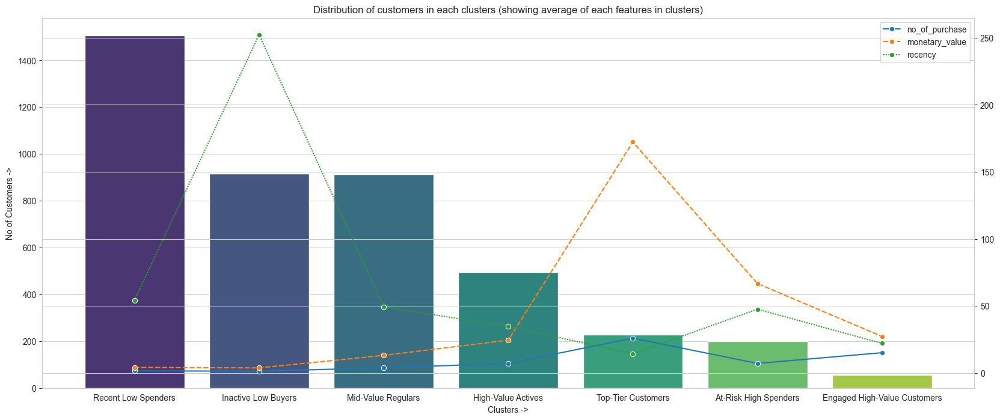

In [342]:
fig,ax1 = plt.subplots(figsize=(20,8))
sns.barplot(cluster_counts,ax=ax1,palette='viridis')
ax1.set_ylabel('No of Customers ->')
ax1.set_xlabel('Clusters ->')
ax1.set_title('Distribution of customers in each clusters (showing average of each features in clusters)')
ax2 = ax1.twinx()
sns.lineplot(data=features_mean,ax=ax2,markers='o')